# Notebook - Visualizations on the network

# Data is read and the some transformations are done for easy disections of the dataset for analysis

In [5]:
library(maps)
library(geosphere)
library(igraph)

data = readRDS('/Users/gautamborgohain/Google Drive/Social Media Analytics/modData4.rds')

names(data)[names(data) %in% c('lat','long','lat1','long1')] = c('From_lat','From_lon','To_lat','To_lon')

data$ISPAID = 1
data[data$Trans_Value %in% c('Signed','Free','Trainee','Transfer','Youth',' ','Nominal','NA','Swap',
                                              'Dead','Unknown'),]$ISPAID = 0
data[is.na(data$Trans_Value),]$ISPAID = 0

data[,c('From_League','To_League')] = "Other"
data[data$From_Nat %in% c('United Kingdom'),]$From_League = 'UK'
data[data$From_Nat %in% c('Germany'),]$From_League = 'Germany'
data[data$From_Nat %in% c('Spain'),]$From_League = 'Spain'
data[data$From_Nat %in% c('Italy'),]$From_League = 'Italy'z`
data[data$From_Nat %in% c('France'),]$From_League = 'France'

data[data$To_Nat %in% c('United Kingdom'),]$To_League = 'UK'
data[data$To_Nat %in% c('Germany'),]$To_League = 'Germany'
data[data$To_Nat %in% c('Spain'),]$To_League = 'Spain'
data[data$To_Nat %in% c('Italy'),]$To_League = 'Italy'
data[data$To_Nat %in% c('France'),]$To_League = 'France'

data['ID'] = 1:nrow(data)

In [6]:
data[data$From_Club == 'Espanyol',]$From_lat = 41.348
data[data$From_Club == 'Espanyol',]$From_lon = 2.07
data[data$To_Club == 'Espanyol',]$To_lat = 41.348
data[data$To_Club == 'Espanyol',]$To_lon = 2.07

In [110]:
data$From_lon = as.numeric(as.character(data$From_lon))


# Map of all transfers

## The transfer data obtained are plotted on a map to visualize the network

In [109]:
# Subset to only cases where we have geocodes
data_geo = data[complete.cases(data[c('From_lon','From_lat','To_lon','To_lat')]),]
nrow(data_geo)
# head(data_geo)

[1] 3701

In [327]:
plotmap = function (data_geo){
    xlim = c(-20, 59)
    ylim = c(15, 100)

    map("world", col="#f2f2f2", fill=TRUE, bg="white", lwd=0.02,xlim = xlim,ylim = ylim)


    for(i in 1:nrow(data_geo)){
        inter <- gcIntermediate(c(data_geo[i,"From_lon"],data_geo[i,"From_lat"]), c(data_geo[i,"To_lon"],data_geo[i,"To_lat"]), n=100, addStartEnd=TRUE)

        if(data_geo[i,"ISPAID"] == 1){
            lines(inter,col=adjustcolor("red",alpha.f = 0.7),lwd=0.1,type = 'l')
        }
        else{
            lines(inter,col=adjustcolor("blue",alpha.f = 0.4),lwd=0.1,type = 'l')
        }

    }
}

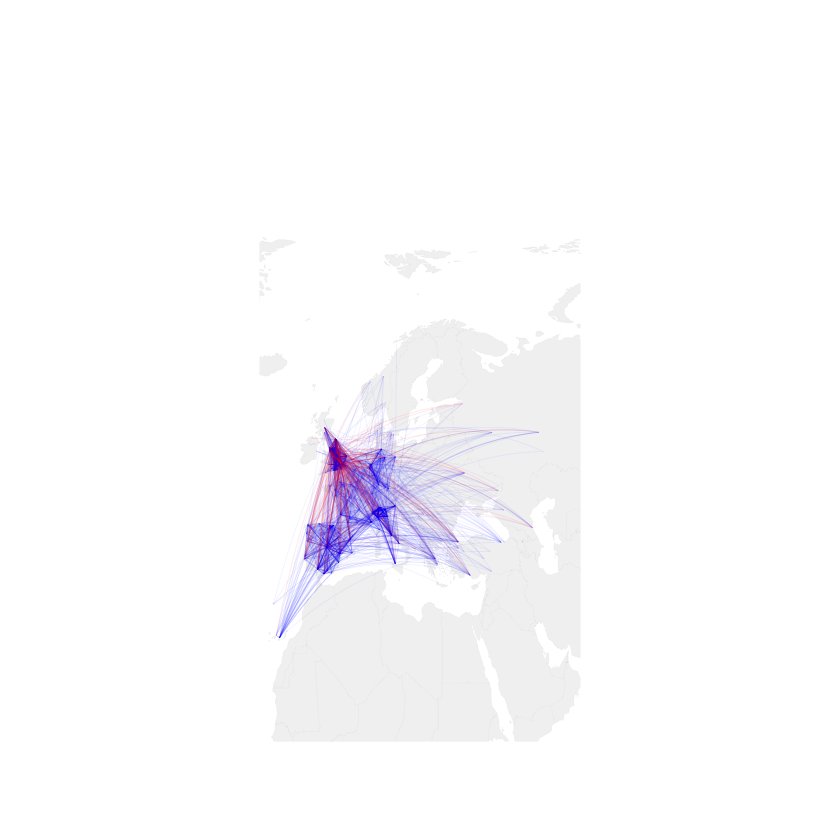

In [328]:
plotmap(data_geo)

# Save it to a PDF for sharing

In [172]:
pdf('/Users/gautamborgohain/Desktop/worldMap_2.pdf')

plotmap(data_geo)
dev.off()

pdf 
  2

## Weighted

# Plotting of the network for which we have the transfer values into a map. The edges are weighted with the transfer values

In [484]:
plotmap2 = function (data_geo){
    xlim = c(-20, 59)
    ylim = c(15, 100)`a

    map("world", col="white", fill=TRUE, bg="white", lwd=0.02,xlim = xlim,ylim = ylim)

    meanVal = mean(data_geo$Trans_Value)
    for(i in 1:nrow(data_geo)){
        inter <- gcIntermediate(c(data_geo[i,"From_lon"],data_geo[i,"From_lat"]), c(data_geo[i,"To_lon"],data_geo[i,"To_lat"]), n=100, addStartEnd=TRUE)

        lines(inter,col=adjustcolor("red",alpha.f = 0.5),lwd=round((data_geo[i,'Trans_Value']/(meanVal*3))),type = 'l')

    }
}

In [480]:
df_paid_geo = data_geo[data_geo$ISPAID == 1,]
df_paid_geo = df_paid_geo[complete.cases(df_paid_geo[c('From_lon','From_lat','To_lon','To_lat','Trans_Value')]),]
df_paid_geo$Trans_Value = as.numeric(as.character(df_paid_geo$Trans_Value))

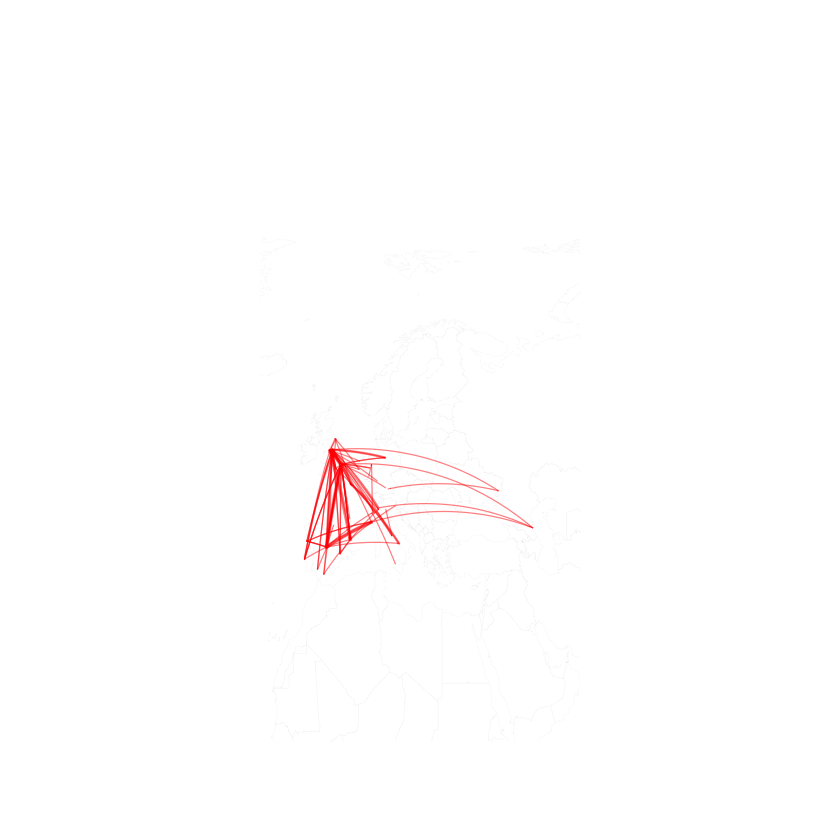

In [485]:
plotmap2(df_paid_geo)

In [486]:
pdf('/Users/gautamborgohain/Desktop/worldMap_weighted.pdf')

plotmap2(df_paid_geo)
dev.off()

pdf 
  2

# Network of the leagues

## All the leagues

# Plotting of the transfers onto a network using igraph to get the various metrics and to correlate with other inferences

In [14]:
library(igraph)

radian.rescale <- function(x, start=0, direction=1) {
    c.rotate <- function(x) (x + start) %% (2 * pi) * direction
    c.rotate(scales::rescale(x, c(0, 2 * pi), range(x)))
    }
    
xlim=c(-110,150)
ylim = c(-40, -10)

plotnetworks = function(df_paid){
    #Nodes
    df_paid = df_paid[complete.cases(df_paid[c('From_lon','From_lat','To_lon','To_lat')]),]
    nodes_1 = (subset(df_paid, select = c('From_Club','From_League','From_lat','From_lon')))
    nodes_2 = (subset(df_paid, select = c('To_Club','To_League','To_lat','To_lon')))
    names(nodes_1)[names(nodes_1) %in% c('From_Club','From_League','From_lat','From_lon')] = c('Club','League','lat','lon')
    names(nodes_2)[names(nodes_2) %in% c('To_Club','To_League','To_lat','To_lon')] = c('Club','League','lat','lon')
    nodes = rbind(nodes_1,nodes_2)
    nodes = nodes[!duplicated(nodes$Club),]
    #Edges
    edge = subset(df_paid,select = c('From_Club','To_Club'))
    
    #Colors
    pal3 <- colorRampPalette(c("orange","yellow","green","gray","red","blue"))
    colors <- adjustcolor(pal3(length(table(nodes$League))), alpha.f = 0.7)    
    lookup = as.data.frame(table(nodes$League), columns = c('Var1','Freq'))
    lookup$Freq = colors
    nodes = merge(nodes,lookup,by.x = 'League',by.y ='Var1', all.x= TRUE)
    nodes = nodes[,c(2,1,3,4,5)] # reorder to put Club names first
    
    #iGraph prepare
    g = graph.data.frame(edge,nodes,directed= T)
    g = simplify(g)
    V(g)$color = nodes$Freq
#     deg = degree(g)
#     deg = min(sort(deg,decreasing = T)[10])
    V(g)$size = degree(g)/2
    V(g)$label = V(g)$name

#     print(degree(g))
    n = nrow(nodes)    

    E(g)$arrow.size <- 0.5
#     E(g)$width <- E(g)$Trans_Value/mean(df_paid$Trans_Value)

    lab.locs <- radian.rescale(x=1:n, direction=-1, start=0)
    lay = layout.norm(as.matrix(nodes[,c('lon','lat')]))

#     V(g)$size = 5
    #Plot
    plot(g,
#          vertex.label = ifelse(degree(g) >= deg, V(g)$label, NA),
         vertex.label = NA,
         vertex.label.dist=1,
#          edge.width = E(g)$width,
         layout = lay,
#          edge.curved = .5,
         edge.color = adjustcolor('black', alpha.f = 0.1),
        vertex.label.color= 'red',
        vertex.label.family = "sans",
        vertex.label.degree=lab.locs,
        )
    
    legend(x=-1.6, y=-0.83,legend = lookup$Var1,lookup$Freq,pt.cex=2, cex=.9,ncol = 1,
      title="European Leagues")
    
    title(df_paid[1,'window'])

}

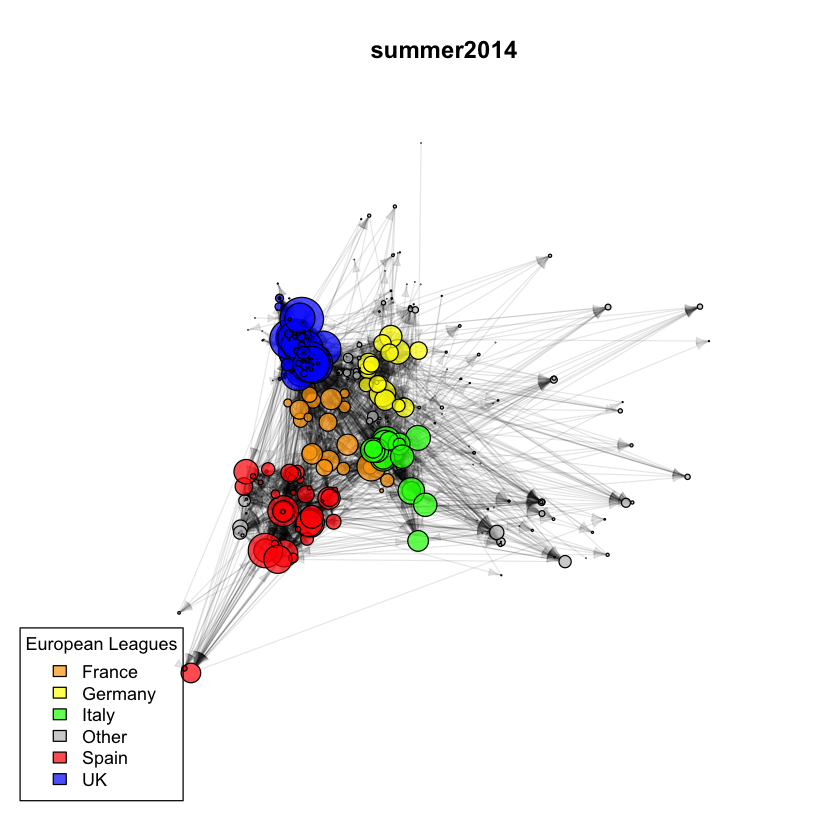

In [501]:
# plotnetworks(subset(data,window == 'summer2015'))
plotnetworks(data)

In [502]:
png('/Users/gautamborgohain/Desktop/combinedplots_2015_2.png', width = 1200, height = 900, res = 100)
plotnetworks(data)
dev.off()

pdf 
  2

In [493]:
png('/Users/gautamborgohain/Desktop/combinedplots_2015_2.png', width = 1200, height = 900, res = 100)
plotnetworks(subset(data,window == 'summer2015'))

dev.off()

pdf 
  2

In [505]:
options(warn = -1)
pdf('/Users/gautamborgohain/Desktop/combinedplots.pdf')
plotnetworks(data)
for(windowToSearch in names(table(data$window))){
    dfSub = subset(data,window == windowToSearch)
    print(paste(nrow(dfSub), windowToSearch))
    plotnetworks(dfSub)
}
dev.off()

[1] "283 summer2010"
[1] "716 summer2011"
[1] "838 summer2012"
[1] "864 summer2013"
[1] "886 summer2014"
[1] "927 summer2015"
[1] "112 winter2011"
[1] "157 winter2012"
[1] "159 winter2013"
[1] "174 winter2014"
[1] "170 winter2015"
[1] "195 winter2016"


pdf 
  2


## All leagues - Weighted

In [150]:


library(igraph)

radian.rescale <- function(x, start=0, direction=1) {
    c.rotate <- function(x) (x + start) %% (2 * pi) * direction
    c.rotate(scales::rescale(x, c(0, 2 * pi), range(x)))
    }
    

plotnetworks2 = function(df_paid){
    #Nodes
    df_paid = df_paid[complete.cases(df_paid[c('From_lon','From_lat','To_lon','To_lat','Trans_Value')]),]
    df_paid$Trans_Value = as.numeric(as.character(df_paid$Trans_Value))
    nodes_1 = (subset(df_paid, select = c('From_Club','From_League','From_lat','From_lon')))
    nodes_2 = (subset(df_paid, select = c('To_Club','To_League','To_lat','To_lon')))
    names(nodes_1)[names(nodes_1) %in% c('From_Club','From_League','From_lat','From_lon')] = c('Club','League','lat','lon')
    names(nodes_2)[names(nodes_2) %in% c('To_Club','To_League','To_lat','To_lon')] = c('Club','League','lat','lon')
    nodes = rbind(nodes_1,nodes_2)
    nodes = nodes[!duplicated(nodes$Club),]
    #Edges
    edge = subset(df_paid,select = c('From_Club','To_Club','Trans_Value'))
#     edge = 
    
    #Colors
    pal3 <- colorRampPalette(c("red","blue"))
    colors <- adjustcolor(pal3(length(table(nodes$League))), alpha.f = 0.5)
    lookup = as.data.frame(table(nodes$League), columns = c('Var1','Freq'))
    lookup$Freq = colors
    nodes = merge(nodes,lookup,by.x = 'League',by.y ='Var1', all.x= TRUE)
    nodes = nodes[,c(2,1,3,4,5)] # reorder to put Club names first
    lay = layout.norm(as.matrix(nodes[,c('lon','lat')]))
    
    #iGraph prepare
    g = graph.data.frame(edge,nodes,directed= T)
    g = simplify(g)
    V(g)$color = nodes$Freq
    deg = degree(g)
    deg = sort(deg,decreasing = T)
#     min = min(deg[3])

    V(g)$size = degree(g)/2
    V(g)$label = V(g)$name

#     print(degree(g))
    n = nrow(nodes)    

    E(g)$arrow.size <- 0.5
    E(g)$width <- edge$Trans_Value/6000000

    lab.locs <- radian.rescale(x=1:n, direction=-1, start=0)
    edge_color_alpha = adjustcolor('black', alpha.f = 0.2)
    edge_color_TRANS = adjustcolor('black', alpha.f = 0.0)
    

#     V(g)$size = 5
    #Plot
    plot(g,
         vertex.label = ifelse(degree(g) >= min(head(deg,4)), V(g)$label, NA),
#          edge.width = ifelse(E(g)$width>2, E(g)$width,NA),
         vertex.label = NA,
         vertex.label.dist=0.5,
         layout = lay,
#          edge.curved = .5,
#          edge.color = ifelse(E(g)$width>1,edge_color_alpha,edge_color_TRANS),
         edge.color = edge_color_alpha,
        vertex.label.color= 'red',
        vertex.label.family = "sans",
#         vertex.label.degree=lab.locs,
        vertex.label.cex = 0.6)
    
    legend(x=-1.6, y=-0.83,legend = lookup$Var1,lookup$Freq,pt.cex=2, cex=.9,ncol = 1,
      title="European Leagues")
    
    title(df_paid[1,'window'])

}

Warning message:
In plotnetworks2(data): NAs introduced by coercionWarning message:
In eattrs[[name]][index] <- value: number of items to replace is not a multiple of replacement length

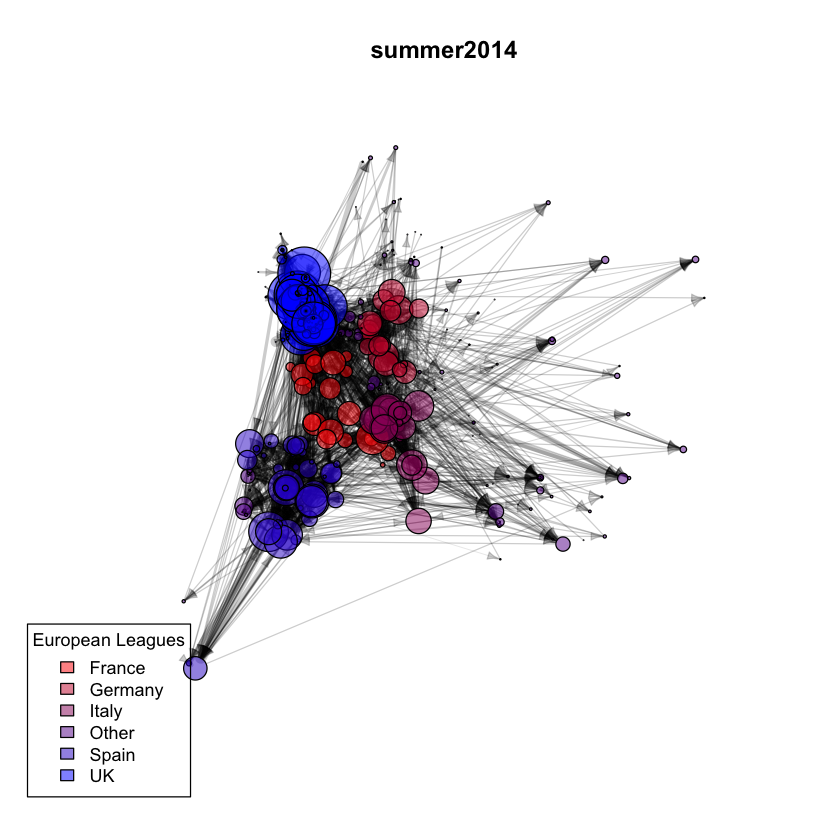

In [145]:
#All
#data$window == 'summer2015' & 
# png('/Users/gautamborgohain/Desktop/combinedplots_2_weight.png', width = 1200, height = 900, res = 100)
plotnetworks2(data)
# dev.off()

## Just the paid transfers

Warning message:
In eattrs[[name]][index] <- value: number of items to replace is not a multiple of replacement length

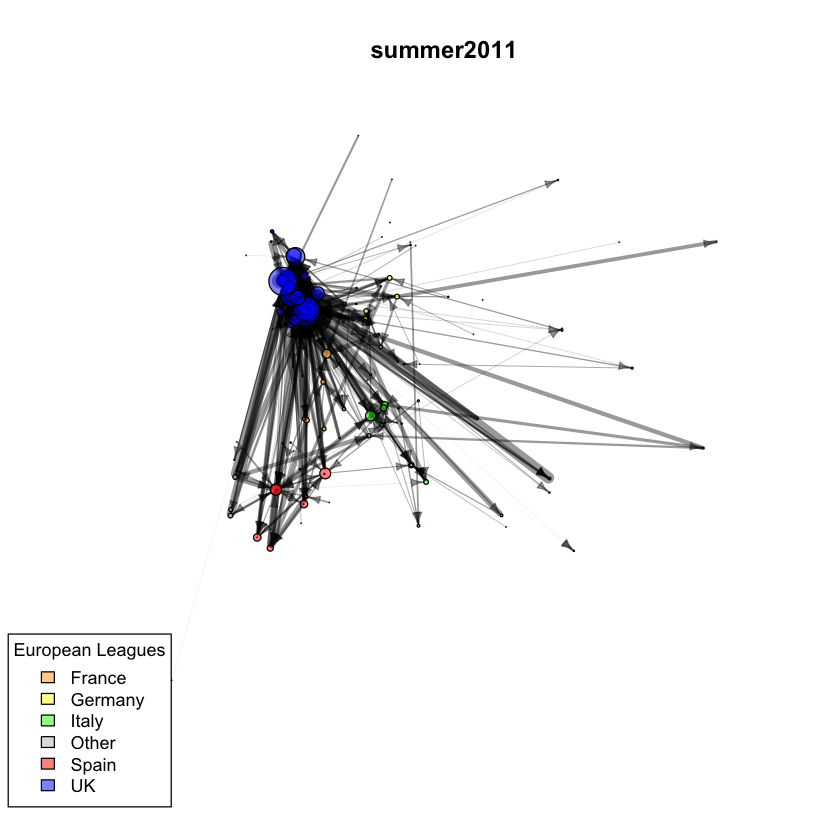

In [11]:
#Paid
#data$window == 'summer2015' & 
#opacity = 0.4
# png('/Users/gautamborgohain/Desktop/combinedplots_2_paid_weight.png', width = 1200, height = 900, res = 100)
plotnetworks2(data[data$ISPAID == 1,])
# dev.off()

## Unpaid transfers

Warning message:
In plotnetworks2(data[data$ISPAID == 0, ]): NAs introduced by coercionWarning message:
In eattrs[[name]][index] <- value: number of items to replace is not a multiple of replacement length

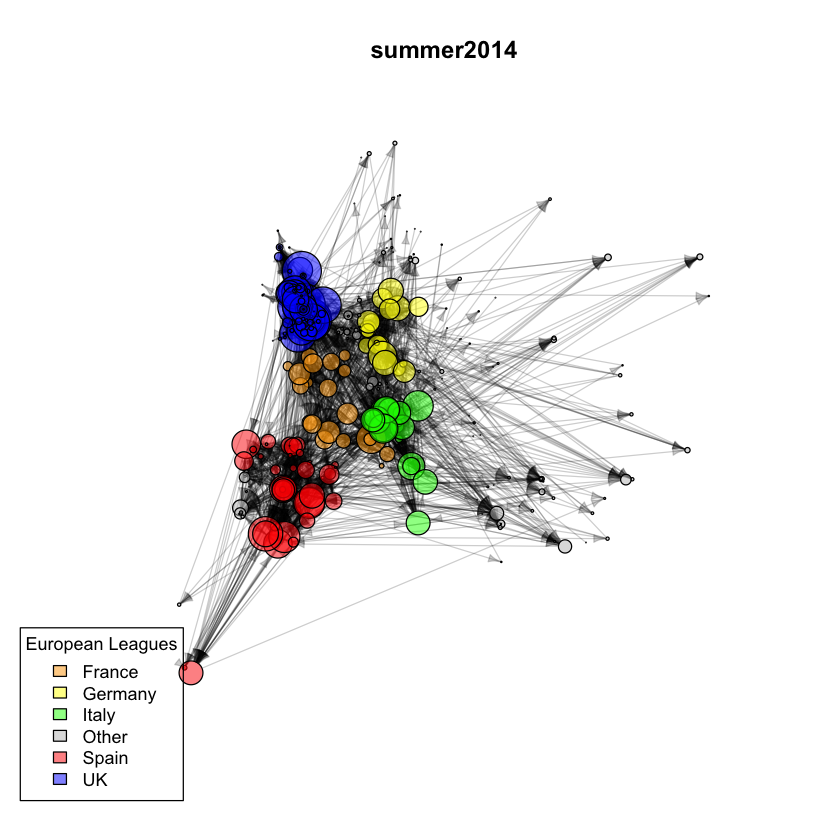

In [16]:
#UN-Paid
# png('/Users/gautamborgohain/Desktop/combinedplots_2_unpaid_weight.png', width = 1200, height = 900, res = 100)
plotnetworks2(data[data$ISPAID == 0,])
# dev.off()

## Spain Paid network

Warning message:
In eattrs[[name]][index] <- value: number of items to replace is not a multiple of replacement length

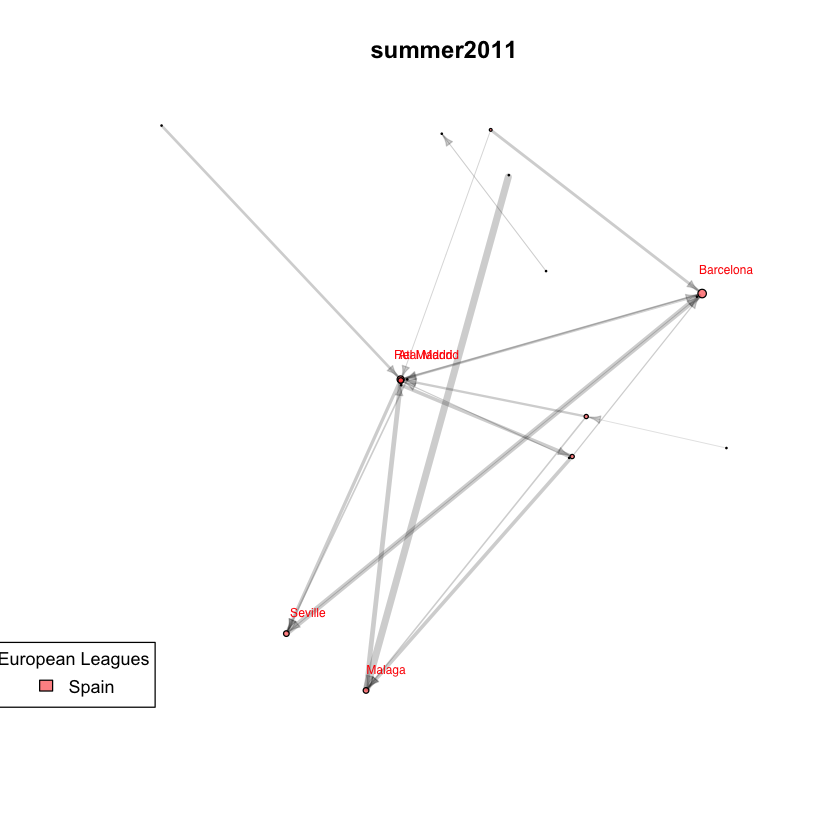

In [153]:
# Weighted
#& data$window == 'summer2015'
#
# png('/Users/gautamborgohain/Desktop/combinedplots_2_spain_paid_weight2.png', width = 1200, height = 900, res = 100)
plotnetworks2(data[data$From_League == 'Spain' & data$To_League == 'Spain' & data$ISPAID == 1,])
# df_paid = data[data$From_League == 'UK' & data$To_League == 'UK',]
# dev.off()

## England and Spain network

Warning message:
In plotnetworks2(data[data$From_League %in% c("UK", "Spain") & data$To_League %in% : NAs introduced by coercionWarning message:
In eattrs[[name]][index] <- value: number of items to replace is not a multiple of replacement length

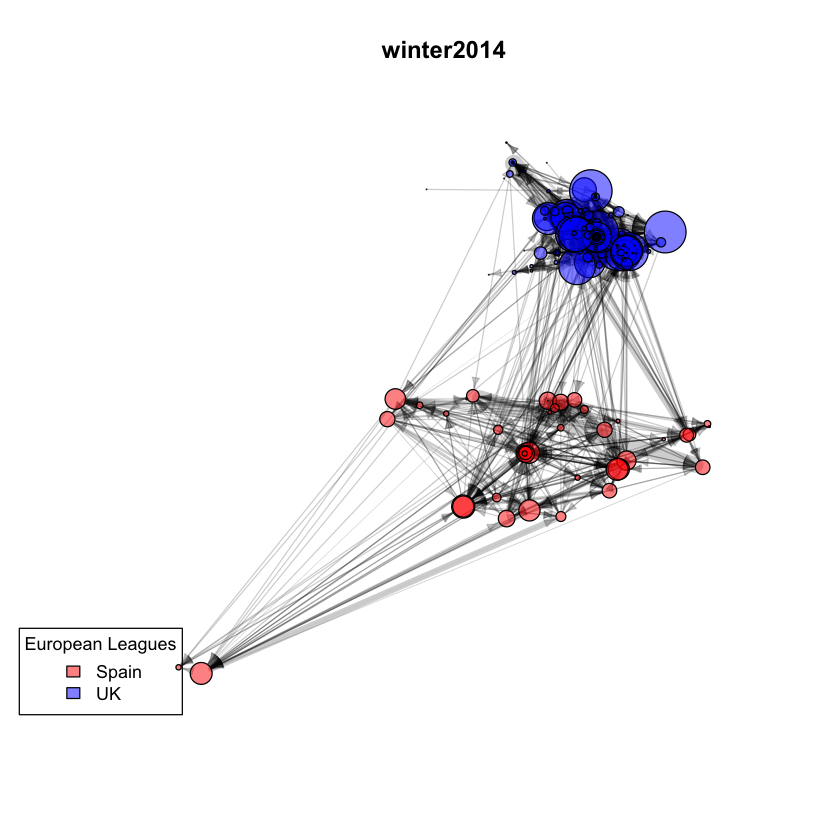

In [146]:
# str(data)
# png('/Users/gautamborgohain/Desktop/combinedplots_2_epl_spain_weight2.png', width = 1200, height = 900, res = 100)
plotnetworks2(data[data$From_League %in% c('UK','Spain') & data$To_League %in% c('UK','Spain'),])
# dev.off()

Plot the transfers within the leagues/ countries and store them in a PDF

In [478]:
options(warn = -1)
pdf('/Users/gautamborgohain/Desktop/combinedplots_EPL_unweighted.pdf')
plotnetworks(data[data$From_League == 'EPL' & data$To_League == 'EPL',])
for(windowToSearch in names(table(data$window))){
    dfSub = data[data$From_League == 'EPL' & data$To_League == 'EPL'& data$window == windowToSearch,]
    print(paste(nrow(dfSub), windowToSearch))
    plotnetworks(dfSub)
}
dev.off()

[1] "88 summer2010"
[1] "172 summer2011"
[1] "186 summer2012"
[1] "159 summer2013"
[1] "167 summer2014"
[1] "161 summer2015"
[1] "47 winter2011"
[1] "50 winter2012"
[1] "45 winter2013"
[1] "54 winter2014"
[1] "40 winter2015"
[1] "43 winter2016"


pdf 
  2

In [65]:
options(warn = -1)
pdf('/Users/gautamborgohain/Desktop/combinedplots_Bundesliga.pdf')
plotnetworks2(data[data$From_League == 'Bundesliga' & data$To_League == 'Bundesliga',])
for(windowToSearch in names(table(data$window))){
    dfSub = data[data$From_League == 'Bundesliga' & data$To_League == 'Bundesliga'& data$window == windowToSearch,]
    print(paste(nrow(dfSub), windowToSearch))
    plotnetworks2(dfSub)
}
dev.off()

[1] "19 summer2010"
[1] "68 summer2011"
[1] "90 summer2012"
[1] "72 summer2013"
[1] "106 summer2014"
[1] "111 summer2015"
[1] "8 winter2011"
[1] "16 winter2012"
[1] "10 winter2013"
[1] "11 winter2014"
[1] "16 winter2015"
[1] "14 winter2016"


pdf 
  2

In [66]:
options(warn = -1)
pdf('/Users/gautamborgohain/Desktop/combinedplots_La_Liga.pdf')
plotnetworks2(data[data$From_League == 'La_Liga' & data$To_League == 'La_Liga',])
for(windowToSearch in names(table(data$window))){
    dfSub = data[data$From_League == 'La_Liga' & data$To_League == 'La_Liga'& data$window == windowToSearch,]
    print(paste(nrow(dfSub), windowToSearch))
    plotnetworks2(dfSub)
}
dev.off()

[1] "57 summer2010"
[1] "88 summer2011"
[1] "93 summer2012"
[1] "118 summer2013"
[1] "115 summer2014"
[1] "100 summer2015"
[1] "10 winter2011"
[1] "20 winter2012"
[1] "27 winter2013"
[1] "19 winter2014"
[1] "18 winter2015"
[1] "31 winter2016"


pdf 
  2

In [67]:
options(warn = -1)
pdf('/Users/gautamborgohain/Desktop/combinedplots_Serie A.pdf')
plotnetworks2(data[data$From_League == 'Serie A' & data$To_League == 'Serie A',])
for(windowToSearch in names(table(data$window))){
    dfSub = data[data$From_League == 'Serie A' & data$To_League == 'Serie A'& data$window == windowToSearch,]
    print(paste(nrow(dfSub), windowToSearch))
    plotnetworks2(dfSub)
}
dev.off()

[1] "32 summer2010"
[1] "80 summer2011"
[1] "94 summer2012"
[1] "97 summer2013"
[1] "104 summer2014"
[1] "86 summer2015"
[1] "19 winter2011"
[1] "20 winter2012"
[1] "23 winter2013"
[1] "21 winter2014"
[1] "19 winter2015"
[1] "24 winter2016"


pdf 
  2

In [68]:
options(warn = -1)
pdf('/Users/gautamborgohain/Desktop/combinedplots_Ligue_1.pdf')
plotnetworks2(data[data$From_League == 'Ligue_1' & data$To_League == 'Ligue_1',])
for(windowToSearch in names(table(data$window))){
    dfSub = data[data$From_League == 'Ligue_1' & data$To_League == 'Ligue_1'& data$window == windowToSearch,]
    print(paste(nrow(dfSub), windowToSearch))
    plotnetworks2(dfSub)
}
dev.off()

[1] "15 summer2010"
[1] "64 summer2011"
[1] "62 summer2012"
[1] "75 summer2013"
[1] "47 summer2014"
[1] "63 summer2015"
[1] "4 winter2011"
[1] "11 winter2012"
[1] "7 winter2013"
[1] "9 winter2014"
[1] "14 winter2015"
[1] "9 winter2016"


pdf 
  2

# Transfer Between leagues

In [92]:
plotnetworksLEAGUES = function(df){
    #Nodes -  Just the league names are required here
    nodes = unique(c(temp$From_League,temp$To_League))
    #Edges
    edge = subset(df,select = c('From_League','To_League'))
    #iGraph prepare
    colors = adjustcolor(c("blue","green","red","yellow","orange","gray"), alpha.f = .5)
    g = graph.data.frame(edge,nodes,directed= T)
    g = simplify(g, remove.multiple = T, remove.loops = F)
    V(g)$color = colors
    n = nrow(nodes)    

    E(g)$arrow.size <- 1
    E(g)$width  = degree(g)
    
    V(g)$size = degree(g)*10
    #Plot
    plot(g,
         vertex.label.dist=1.5,
         vertex.label = NA,
         layout = layout.circle,
         edge.color = 'black',
        vertex.label.family = "sans")
    
    legend(x=-1.6, y=-0.83,legend = names(V(g)),colors,pt.cex=2, cex=.9,ncol = 1,
      title="European Leagues")
    
    title('Transfer Flows in Leagues')
}


## EPL has the highest inflow of foreighners

In [90]:
png('/Users/gautamborgohain/Desktop/flows_in.png', width = 1200, height = 900, res = 100)
temp = data[(data$From_League != data$To_League) & data$From_League == 'Other',]

plotnetworksLEAGUES(temp)
dev.off()

Warning message:
In eattrs[[name]][index] <- value: number of items to replace is not a multiple of replacement length

pdf 
  2

## While all have equivalent number of exports

In [94]:
png('/Users/gautamborgohain/Desktop/flows_out.png', width = 1200, height = 900, res = 100)
temp = data[(data$From_League != data$To_League) & data$To_League == 'Other',]

plotnetworksLEAGUES(temp)

dev.off()

Warning message:
In eattrs[[name]][index] <- value: number of items to replace is not a multiple of replacement length

pdf 
  2

# Foreign Players

In [160]:
library(igraph)

radian.rescale <- function(x, start=0, direction=1) {
    c.rotate <- function(x) (x + start) %% (2 * pi) * direction
    c.rotate(scales::rescale(x, c(0, 2 * pi), range(x)))
    }
    

plotnetworks3 = function(df_paid){
    #Nodes
    df_paid = df_paid[complete.cases(df_paid[c('From_lon','From_lat','To_lon','To_lat','Trans_Value')]),]
    df_paid$Trans_Value = as.numeric(as.character(df_paid$Trans_Value))
    df_paid$To_Nat = as.character(df_paid$To_Nat)
    df_paid$Nationality = as.character(df_paid$Nationality)
    notforeignercolor = adjustcolor('black', alpha.f = 0.1)
    foreignercolor = adjustcolor('violet', alpha.f = 0.1)
    df_paid['Foreign'] = notforeignercolor
    df_paid$Foreign[df_paid$To_Nat != df_paid$Nationality] = foreignercolor
    nodes_1 = (subset(df_paid, select = c('From_Club','From_League','From_lat','From_lon')))
    nodes_2 = (subset(df_paid, select = c('To_Club','To_League','To_lat','To_lon')))
    names(nodes_1)[names(nodes_1) %in% c('From_Club','From_League','From_lat','From_lon')] = c('Club','League','lat','lon')
    names(nodes_2)[names(nodes_2) %in% c('To_Club','To_League','To_lat','To_lon')] = c('Club','League','lat','lon')
    nodes = rbind(nodes_1,nodes_2)
    nodes = nodes[!duplicated(nodes$Club),]
    #Edges
    edge = subset(df_paid,select = c('From_Club','To_Club','Trans_Value','Foreign'))
#     edge = 
    
    #Colors
    pal3 <- colorRampPalette(c("green","yellow","green","gray","red","blue"))
    colors <- adjustcolor(pal3(length(table(nodes$League))), alpha.f = 0.4)
    lookup = as.data.frame(table(nodes$League), columns = c('Var1','Freq'))
    lookup$Freq = colors
    nodes = merge(nodes,lookup,by.x = 'League',by.y ='Var1', all.x= TRUE)
    nodes = nodes[,c(2,1,3,4,5)] # reorder to put Club names first
    lay = layout.norm(as.matrix(nodes[,c('lon','lat')]))
    
    #iGraph prepare
    g = graph.data.frame(edge,nodes,directed= T)
    g = simplify(g)
    V(g)$color = nodes$Freq
    deg = degree(g)
    deg = sort(deg,decreasing = T)
#     min = min(deg[3])

    V(g)$size = degree(g)/4
    V(g)$label = V(g)$name

#     print(degree(g))
    n = nrow(nodes)    

    E(g)$arrow.size <- 0.5
    E(g)$width <- edge$Trans_Value/6000000
    E(g)$color = edge$Foreign

    lab.locs <- radian.rescale(x=1:n, direction=-1, start=0)
    edge_color_alpha = adjustcolor('black', alpha.f = 0.2)
    edge_color_TRANS = adjustcolor('black', alpha.f = 0.0)
    

#     V(g)$size = 5
    #Plot
    plot(g,
#          vertex.label = ifelse(degree(g) >= min(head(deg,4)), V(g)$label, NA),
#          edge.width = ifelse(E(g)$width>2, E(g)$width,NA),
         vertex.label = NA,
         vertex.label.dist=0.5,
         layout = lay,
#          edge.curved = .5,
#          edge.color = ifelse(edge$Foreign == 1,edge_color_alpha,edge_color_TRANS),
#          edge.color = edge_color_alpha,
        vertex.label.color= 'red',
        vertex.label.family = "sans",
#         vertex.label.degree=lab.locs,
        vertex.label.cex = 0.6)
    
    legend(x=-1.6, y=-0.83,legend = lookup$Var1,lookup$Freq,pt.cex=2, cex=.9,ncol = 1,
      title="European Leagues")
    
    title(df_paid[1,'window'])

}

Warning message:
In plotnetworks3(data): NAs introduced by coercionWarning message:
In eattrs[[name]][index] <- value: number of items to replace is not a multiple of replacement lengthWarning message:
In eattrs[[name]][index] <- value: number of items to replace is not a multiple of replacement length

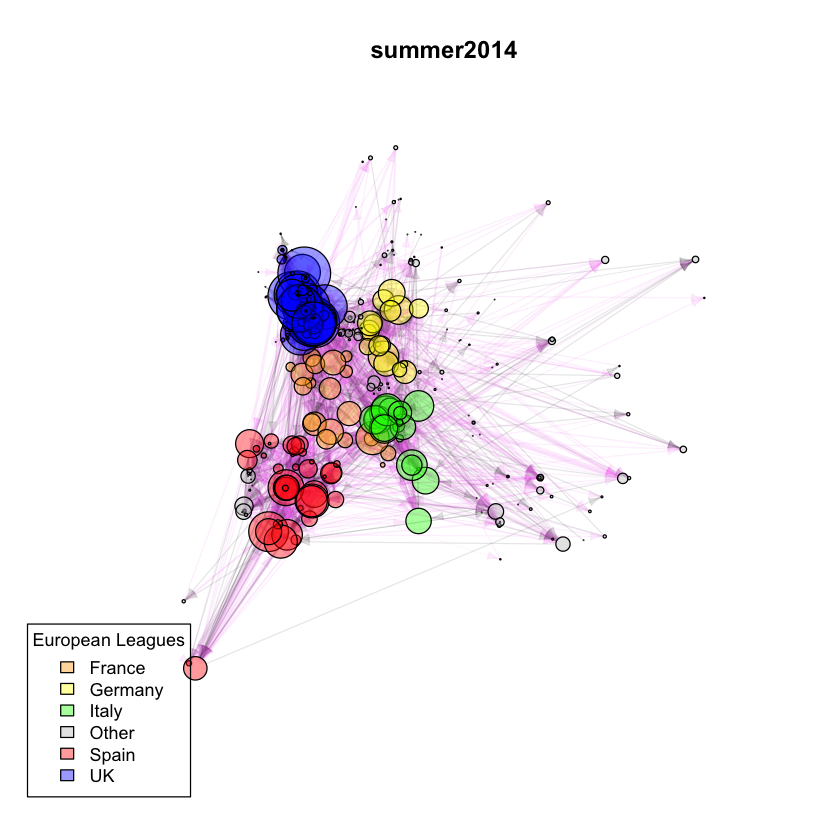

In [137]:
#All
# png('/Users/gautamborgohain/Desktop/foreign_all.png', width = 1200, height = 900, res = 100)
plotnetworks3(data)

# dev.off()

In [136]:
# paid
png('/Users/gautamborgohain/Desktop/flows_out_paid.png', width = 1200, height = 900, res = 100)
plotnetworks3(data[data$ISPAID ==1,])
dev.off()

Warning message:
In eattrs[[name]][index] <- value: number of items to replace is not a multiple of replacement lengthWarning message:
In eattrs[[name]][index] <- value: number of items to replace is not a multiple of replacement length

pdf 
  2

Warning message:
In plotnetworks3(data[data$From_League == "UK" & data$To_League == : NAs introduced by coercionWarning message:
In eattrs[[name]][index] <- value: number of items to replace is not a multiple of replacement lengthWarning message:
In eattrs[[name]][index] <- value: number of items to replace is not a multiple of replacement length

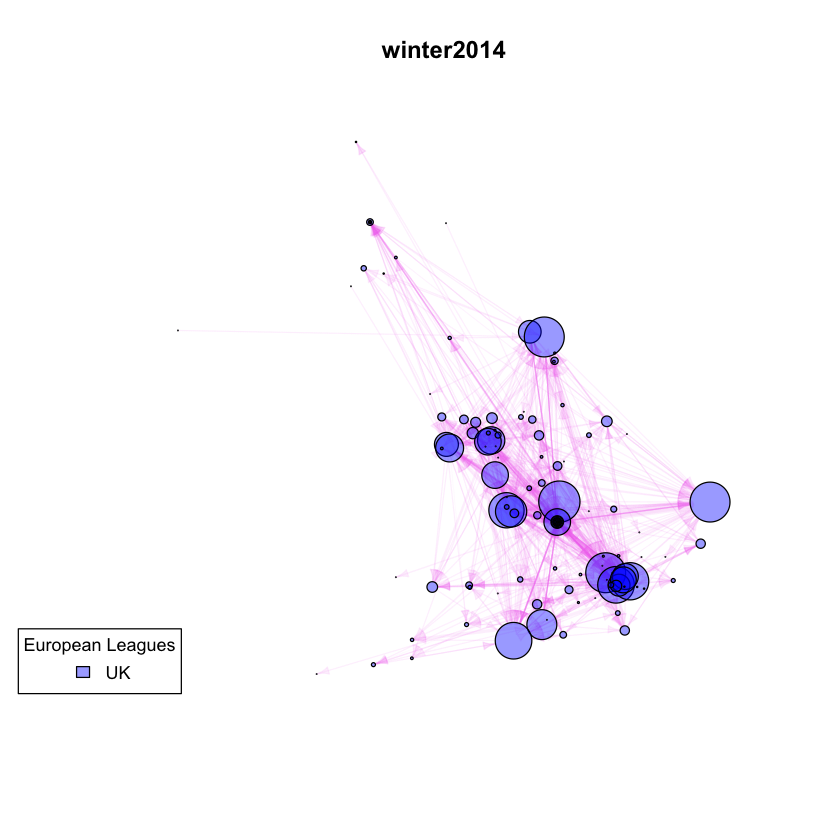

In [141]:
# png('/Users/gautamborgohain/Desktop/foreign_eng_paid.png', width = 1200, height = 900, res = 100)
plotnetworks3(data[data$From_League =='UK'& data$To_League == 'UK',])
# dev.off()

In [161]:
png('/Users/gautamborgohain/Desktop/foreign_italy_paid.png', width = 1200, height = 900, res = 100)
plotnetworks3(data[data$From_League =='Italy'& data$To_League == 'Italy',])
dev.off()

Warning message:
In plotnetworks3(data[data$From_League == "Italy" & data$To_League == : NAs introduced by coercionWarning message:
In eattrs[[name]][index] <- value: number of items to replace is not a multiple of replacement lengthWarning message:
In eattrs[[name]][index] <- value: number of items to replace is not a multiple of replacement length

pdf 
  2